# Classwork

In [1]:
from google.colab import drive

drive.mount('drive')

Mounted at drive


In [3]:
import os
os.chdir('/content/drive/MyDrive/utils')

In [4]:
import numpy as np
import torch
import torch.utils.data
from PIL import Image
import pandas as pd
import engine

from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import torchvision

from PIL.ExifTags import TAGS
from engine import train_one_epoch, evaluate
import utils
from torchvision import transforms as T

In [5]:
class DataSet(torch.utils.data.Dataset):
    
    def __init__(self,root, data_file, transform):
        self.root = root ### mapa cu fotografii
        self.transform = transform
        self.data = pd.read_csv(data_file, sep=';')
        self.imgs = self.data['image_path'].values
        self.path_to_data_file = data_file
        
    def __getitem__(self,idx):
        
        img_path = os.path.join(self.root,self.imgs[idx])
        img = Image.open(img_path).convert('RGB')
        
        
        for orientation in TAGS.keys() : 
            if TAGS[orientation]=='Orientation' : break 
        # Getting the exif
        exif=dict(img.getexif().items())
        # Rotating the image if the orientation is wrong.
        if len(exif)!=0:                                                             
            if orientation in exif.keys():
                if exif[orientation] == 3 : 
                    img=img.rotate(180, expand=True)
                elif exif[orientation] == 6 : 
                    img=img.rotate(270, expand=True)
                elif exif[orientation] == 8 : 
                    img=img.rotate(90, expand=True)
                    
        box_list = self.data[self.data['image_path']==self.imgs[idx]][['x_min','y_min','x_max','y_max']].values
        boxes = torch.as_tensor(box_list, dtype=torch.float32)
        num_obj = len(box_list)
        labels = torch.ones((num_obj,), dtype = torch.int64)
        iscrowd = torch.zeros((num_obj,), dtype=torch.int64)
        area = (boxes[:,3] - boxes[:, 1]) * (boxes[:,2] - boxes[:, 0])
        
        image_id = torch.tensor([idx])
        
        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        target['area'] = area
        target['iscrowd'] = iscrowd
        target['image_id'] = image_id
        
        if self.transform is not None:
            img = self.transform(img)
        
        return img, target
    
    def __len__(self):
        return len(self.data)

In [6]:
transformations = T.Compose([T.ToTensor()])

dataset = DataSet('/content/drive/MyDrive/data',
                  '/content/drive/MyDrive/glasses2.csv',
                  transformations)

torch.manual_seed(1)

indices = torch.randperm(len(dataset)).tolist()
train = torch.utils.data.Subset(dataset, indices[:100])
test = torch.utils.data.Subset(dataset, indices[100:])

train_loader = torch.utils.data.DataLoader(train, batch_size = 1, shuffle=True, collate_fn = utils.collate_fn)
test_loader = torch.utils.data.DataLoader(test, batch_size = 1, shuffle=False, collate_fn = utils.collate_fn)

In [7]:
def get_model(num_clase):
    
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
    
    for param in model.parameters():
        param.required_grad = False
        
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_clase)
    
    return model

In [8]:
DEVICE = torch.device('cuda' if torch.cuda.is_available else 'cpu')

num_clase = 2
model = get_model(num_clase).to(DEVICE)

params = [p for p in model.parameters() if p.requires_grad]

optimizer = torch.optim.SGD(params, lr = 0.005, momentum=0.9, weight_decay = 0.0005)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


  0%|          | 0.00/160M [00:00<?, ?B/s]

In [9]:
num_epoch = 5

for epoch in range(num_epoch):
    
    train_one_epoch(model, optimizer, train_loader, DEVICE, epoch, print_freq = 10)
    
    evaluate(model, test_loader, device=DEVICE)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Epoch: [0]  [  0/100]  eta: 0:02:43  lr: 0.000055  loss: 0.7678 (0.7678)  loss_classifier: 0.7047 (0.7047)  loss_box_reg: 0.0132 (0.0132)  loss_objectness: 0.0389 (0.0389)  loss_rpn_box_reg: 0.0110 (0.0110)  time: 1.6316  data: 0.4145  max mem: 953
Epoch: [0]  [ 10/100]  eta: 0:01:37  lr: 0.000560  loss: 0.5645 (0.5224)  loss_classifier: 0.4156 (0.4136)  loss_box_reg: 0.0314 (0.0561)  loss_objectness: 0.0389 (0.0446)  loss_rpn_box_reg: 0.0077 (0.0080)  time: 1.0832  data: 0.3936  max mem: 1618
Epoch: [0]  [ 20/100]  eta: 0:01:30  lr: 0.001065  loss: 0.2028 (0.3508)  loss_classifier: 0.0985 (0.2579)  loss_box_reg: 0.0431 (0.0539)  loss_objectness: 0.0175 (0.0308)  loss_rpn_box_reg: 0.0052 (0.0083)  time: 1.1006  data: 0.4507  max mem: 1659
Epoch: [0]  [ 30/100]  eta: 0:01:16  lr: 0.001569  loss: 0.1664 (0.3069)  loss_classifier: 0.0874 (0.2105)  loss_box_reg: 0.0605 (0.0646)  loss_objectness: 0.0073 (0.0248)  loss_rpn_box_reg: 0.0039 (0.0070)  time: 1.1055  data: 0.4487  max mem: 1709
E

In [ ]:
#torch.save(model.state_dict(),'/content/drive/MyDrive/CVCamp/CVC_CV_WS_5/utils/fix1_model')

In [10]:
loaded_model = get_model(num_clase=2)
loaded_model.load_state_dict(torch.load('/content/drive/MyDrive/utils/fix1_model/fix1_ports_model.pth'))

<All keys matched successfully>

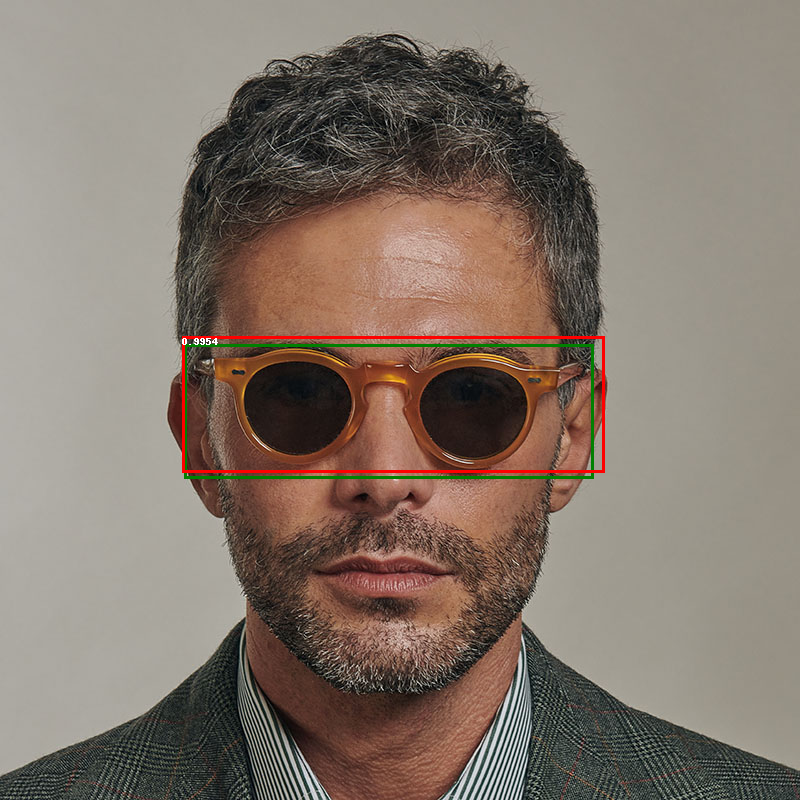

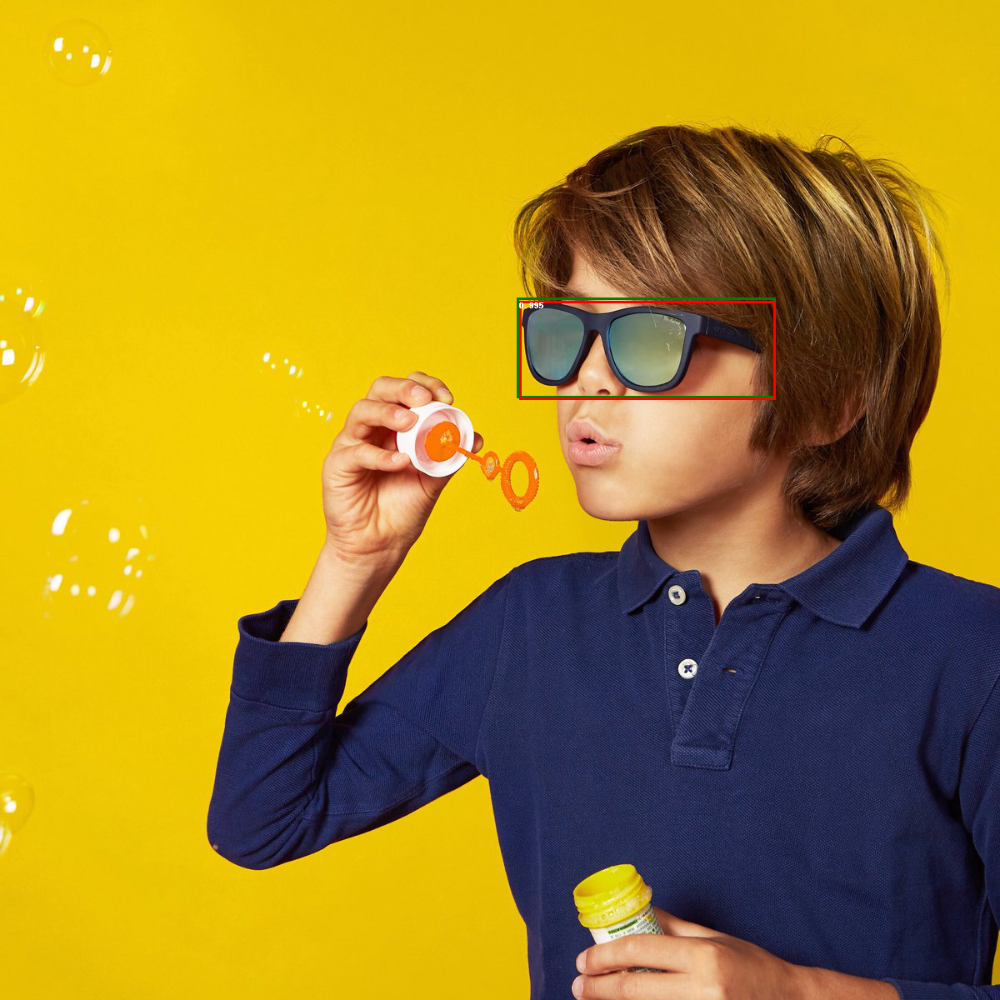

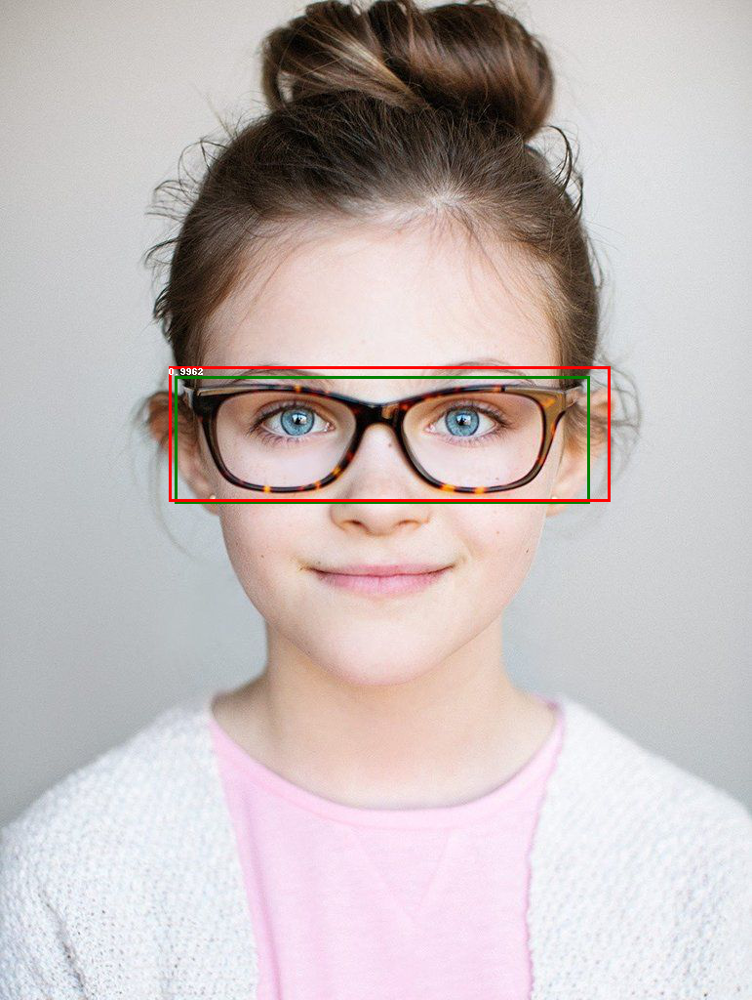

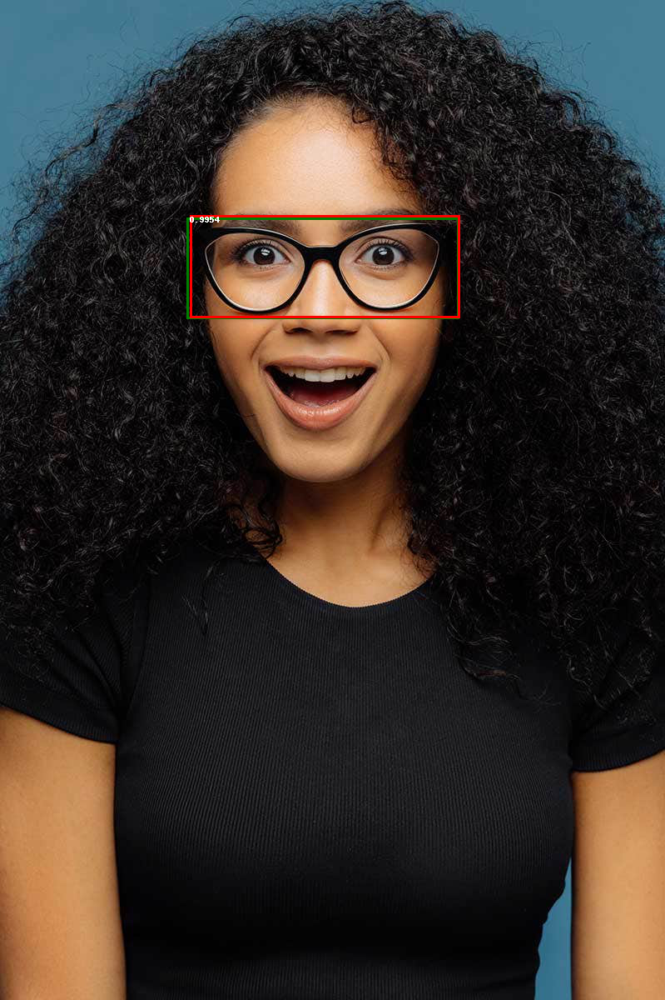

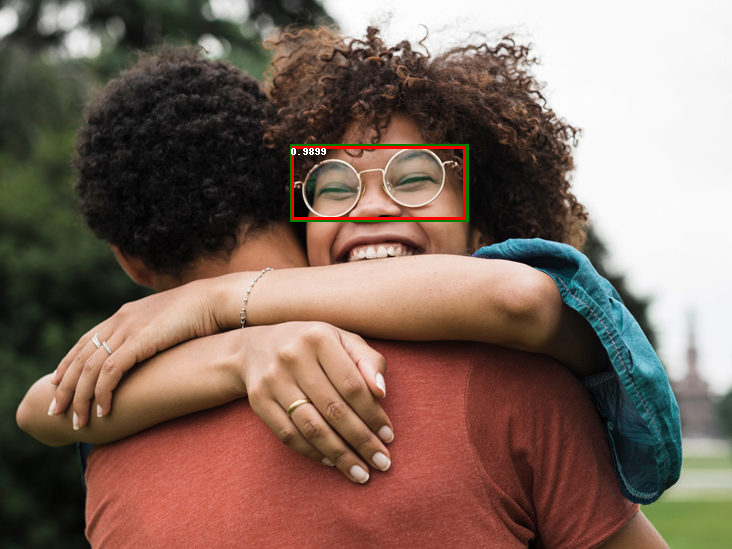

...

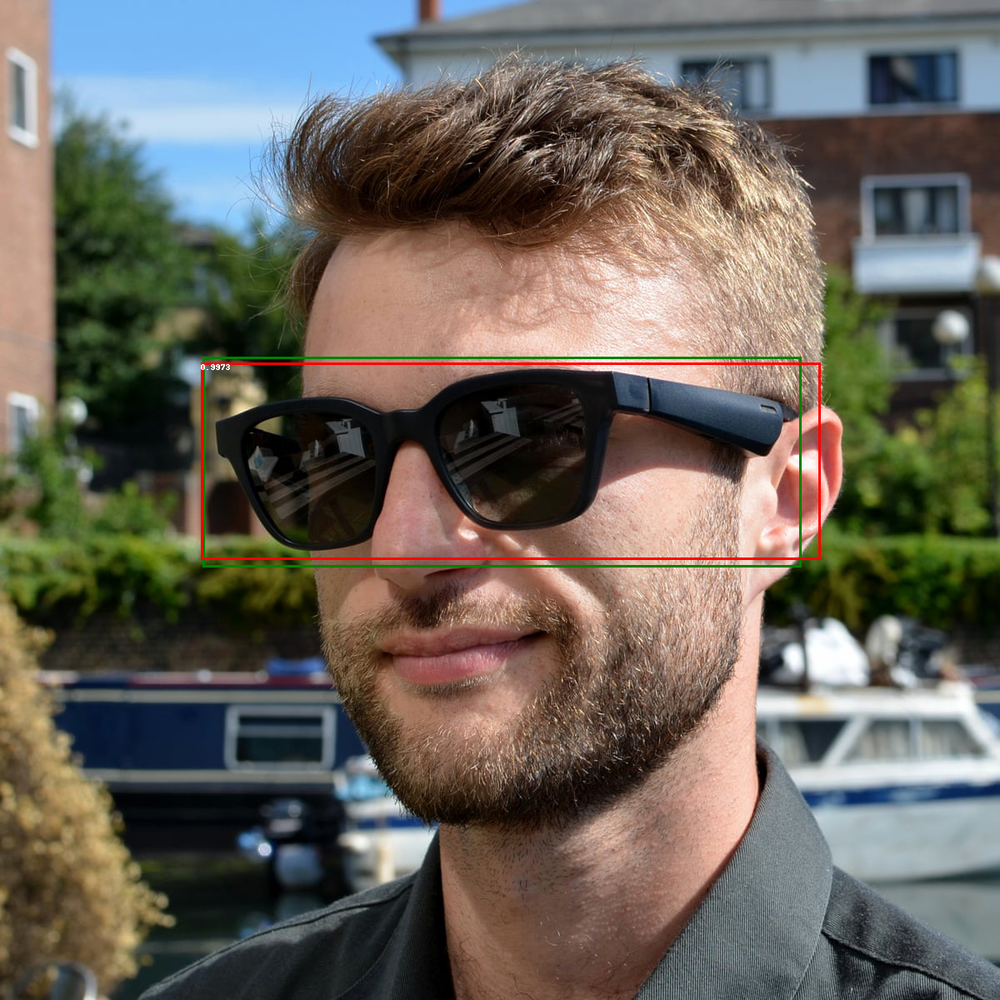

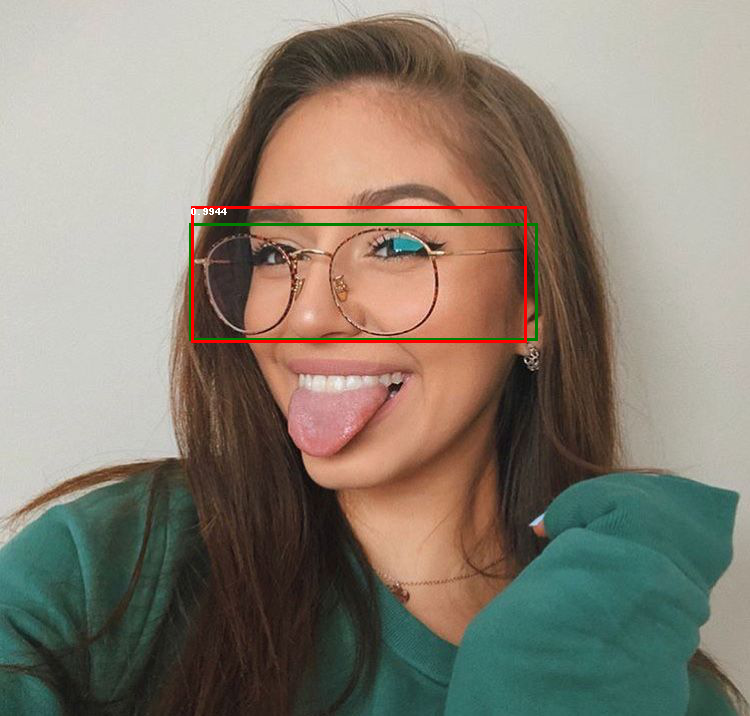

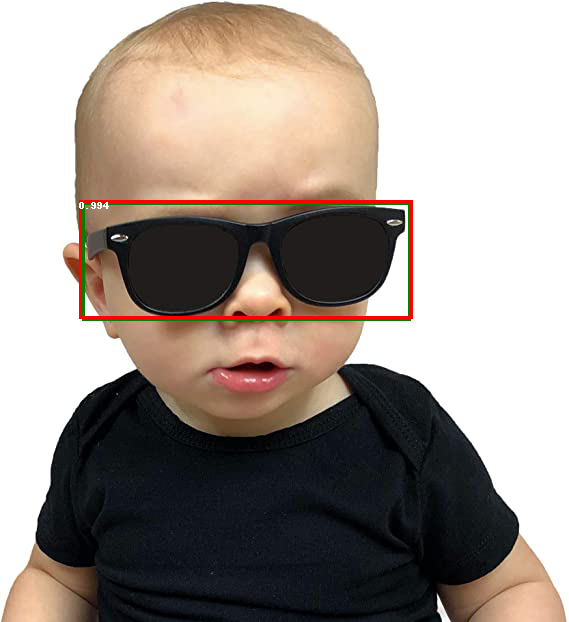

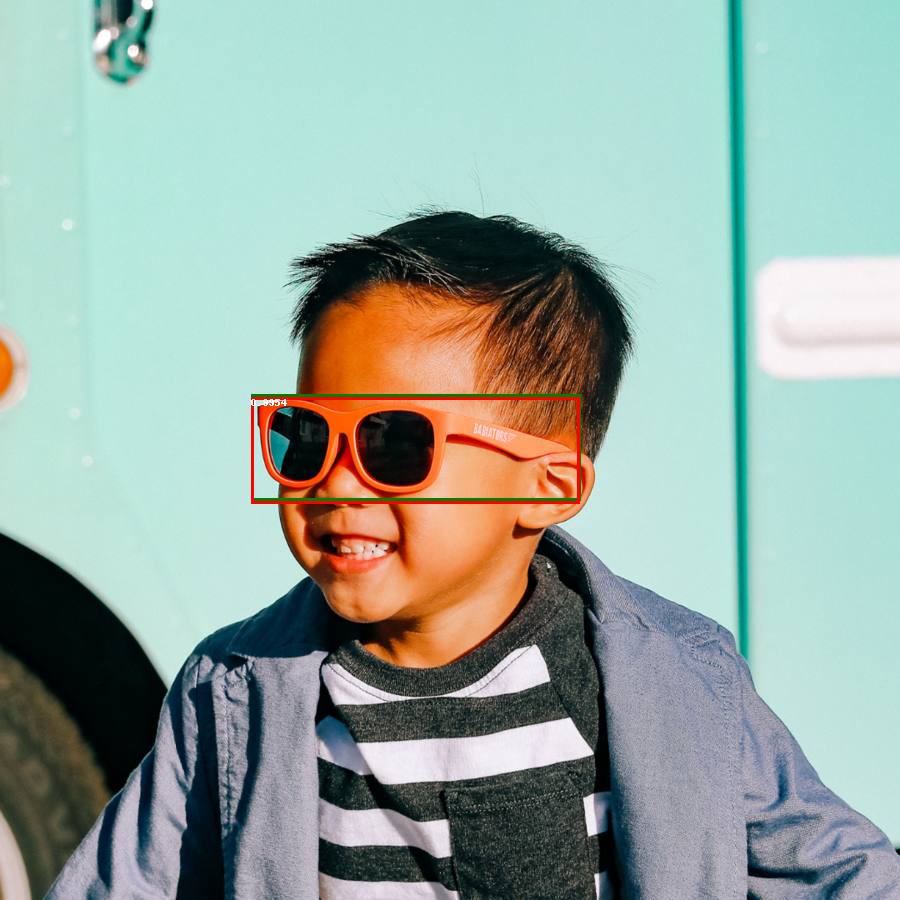

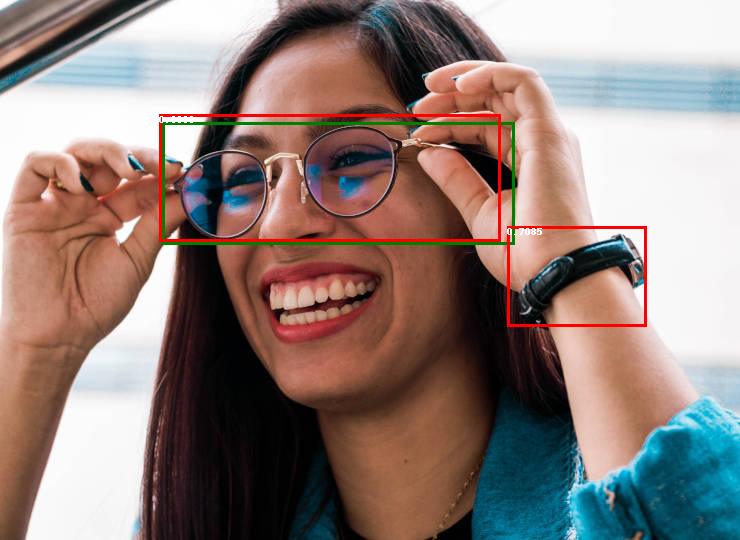

In [11]:
# Use this code to made a predition.
from PIL import ImageDraw
# Getting the image.
for idx in range(2,20):
    img, _ = test[idx]
    # Getting the object coordinates.
    label_boxes = np.array(test[idx][1]['boxes'])

    # Setting the model to eval state.
    loaded_model.eval()
    # Making the prediction.
    with torch.no_grad():
        prediction = loaded_model([img])

    # Getting an drawing the image.
    image = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
    draw = ImageDraw.Draw(image)

    # Drawing the real box around the object.
    for elem in range(len(label_boxes)):
        draw.rectangle([(label_boxes[elem][0], label_boxes[elem][1]),
                       (label_boxes[elem][2], label_boxes[elem][3])],
                      outline='green', width=3)
    # Drawing the predicted box around the object.
    for element in range(len(prediction[0]['boxes'])):
        boxes = prediction[0]['boxes'][element].cpu().numpy()                                     
        score = np.round(prediction[0]['scores'][element].cpu().numpy(), decimals=4)

        if score > 0.2:
            draw.rectangle([(boxes[0], boxes[1]), (boxes[2], boxes[3])],
                         outline='red', width=3)
            draw.text((boxes[0], boxes[1]), text=str(score))
    display(image)

# Homework

In [1]:
from google.colab import drive

drive.mount('drive')

Mounted at drive


In [2]:
!mkdir -p ~/.kaggle
!cp drive/MyDrive/kaggle.json ~/.kaggle
!chmod 600 ~/.kaggle/kaggle.json

In [3]:
!kaggle datasets download --unzip mbkinaci/fruit-images-for-object-detection

 46% 13.0M/28.4M [00:00<00:00, 134MB/s]
100% 28.4M/28.4M [00:00<00:00, 139MB/s]


In [4]:
import os
os.chdir('/content/drive/MyDrive/utils')

In [5]:
import xml.etree.ElementTree as ET
import csv
import numpy as np
import torch
import torch.utils.data
from PIL import Image
import pandas as pd

from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import torchvision

from PIL.ExifTags import TAGS
from engine import train_one_epoch, evaluate
import utils
from torchvision import transforms as T
import shutil

In [8]:
#create a csv with the coordinates
file_train = open('fruits_train.csv', 'a+', newline ='')
with file_train:    
    write = csv.writer(file_train)
    write.writerows([['image_path', 'x_min', 'y_min', 'x_max', 'y_max']])

In [9]:
for dirname, _, filenames in os.walk('/content/train_zip/train'):
    for filename in filenames:
      if filename[-1] == "l":
        print(filename)
        train_path = os.path.join(dirname, filename)
        print(train_path)
        root = ET.parse(train_path).getroot()

        for type_tag in root.findall('object'):
          xmin = type_tag.find('bndbox/xmin').text
          ymin = type_tag.find('bndbox/ymin').text
          xmax = type_tag.find('bndbox/xmax').text
          ymax = type_tag.find('bndbox/ymax').text
          data = [[filename[:-3]+"jpg", xmin, ymin, xmax, ymax]]
          print(data)
          file_train = open('fruits_train.csv', 'a+', newline ='')
          with file_train:    
              write = csv.writer(file_train)
              write.writerows(data)

apple_18.xml
/content/train_zip/train/apple_18.xml
[['apple_18.jpg', '144', '136', '470', '411']]
apple_53.xml
/content/train_zip/train/apple_53.xml
[['apple_53.jpg', '45', '53', '252', '261']]
banana_52.xml
/content/train_zip/train/banana_52.xml
[['banana_52.jpg', '117', '82', '302', '174']]
[['banana_52.jpg', '305', '81', '489', '175']]
orange_62.xml
/content/train_zip/train/orange_62.xml
[['orange_62.jpg', '56', '73', '314', '321']]
[['orange_62.jpg', '357', '35', '656', '334']]
apple_14.xml
/content/train_zip/train/apple_14.xml
[['apple_14.jpg', '318', '146', '680', '511']]
banana_65.xml
/content/train_zip/train/banana_65.xml
[['banana_65.jpg', '170', '37', '498', '339']]
[['banana_65.jpg', '54', '114', '452', '371']]
[['banana_65.jpg', '126', '31', '438', '226']]
banana_55.xml
/content/train_zip/train/banana_55.xml
[['banana_55.jpg', '130', '800', '764', '1800']]
[['banana_55.jpg', '546', '621', '1071', '1679']]
banana_42.xml
/content/train_zip/train/banana_42.xml
[['banana_42.jpg

In [10]:
#create a csv with the coordinates
file_test = open('fruits_test.csv', 'a+', newline ='')
with file_test:    
    write = csv.writer(file_test)
    write.writerows([['image_path', 'x_min', 'y_min', 'x_max', 'y_max']])

In [11]:
for dirname, _, filenames in os.walk('/content/test_zip/test'):
    for filename in filenames:
      if filename[-1] == "l":
        print(filename)
        train_path = os.path.join(dirname, filename)
        print(train_path)
        root = ET.parse(train_path).getroot()

        for type_tag in root.findall('object'):
          xmin = type_tag.find('bndbox/xmin').text
          ymin = type_tag.find('bndbox/ymin').text
          xmax = type_tag.find('bndbox/xmax').text
          ymax = type_tag.find('bndbox/ymax').text
          data = [[filename[:-3]+"jpg", xmin, ymin, xmax, ymax]]
          print(data)
          file_test = open('fruits_test.csv', 'a+', newline ='')
          with file_test:    
              write = csv.writer(file_test)
              write.writerows(data)

mixed_21.xml
/content/test_zip/test/mixed_21.xml
[['mixed_21.jpg', '133', '246', '337', '434']]
[['mixed_21.jpg', '270', '364', '400', '476']]
[['mixed_21.jpg', '522', '344', '649', '470']]
[['mixed_21.jpg', '537', '302', '661', '402']]
[['mixed_21.jpg', '328', '229', '544', '422']]
apple_85.xml
/content/test_zip/test/apple_85.xml
[['apple_85.jpg', '88', '41', '415', '393']]
orange_80.xml
/content/test_zip/test/orange_80.xml
[['orange_80.jpg', '150', '165', '923', '983']]
mixed_22.xml
/content/test_zip/test/mixed_22.xml
[['mixed_22.jpg', '1', '571', '923', '1006']]
[['mixed_22.jpg', '80', '6', '481', '395']]
[['mixed_22.jpg', '543', '17', '942', '430']]
apple_92.xml
/content/test_zip/test/apple_92.xml
[['apple_92.jpg', '77', '74', '540', '518']]
orange_86.xml
/content/test_zip/test/orange_86.xml
[['orange_86.jpg', '165', '163', '367', '336']]
[['orange_86.jpg', '1', '100', '189', '266']]
[['orange_86.jpg', '167', '88', '329', '237']]
apple_88.xml
/content/test_zip/test/apple_88.xml
[['

In [12]:
#both train and test folders contain xtmls and i need to get rid of them in order to have image-only folders.
for dirname, _, filenames in os.walk('/content/train_zip/train'):
    for filename in filenames:
      if filename[-1] == "l":
        train_path = os.path.join(dirname, filename)
        os.unlink(train_path)

for dirname, _, filenames in os.walk('/content/test_zip/test'):
    for filename in filenames:
      if filename[-1] == "l":
        test_path = os.path.join(dirname, filename)
        os.unlink(test_path)  

In [13]:
class DataSet(torch.utils.data.Dataset):
    
    def __init__(self, src, trg, csv1, csv2 , transform):
        #create a single image-only folder
        self.src = src
        self.trg = trg
        files = os.listdir(src)
        for fname in files:
     
            shutil.copy2(os.path.join(src,fname), trg)
        self.root = trg
        self.transform = transform
        #create a single dataframe
        self.data1 = pd.read_csv(csv1)
        self.data2 = pd.read_csv(csv2)
        self.data = self.data1.append(self.data2, sort=False)
        self.imgs = self.data['image_path'].values
        
    def __getitem__(self,idx):
        
        img_path = os.path.join(self.root, self.imgs[idx])
        print(img_path)
        img = Image.open(img_path).convert('RGB')
        
        
        for orientation in TAGS.keys() : 
            if TAGS[orientation]=='Orientation' : break 
        exif=dict(img.getexif().items())
        if len(exif)!=0:                                                             
            if orientation in exif.keys():
                if exif[orientation] == 3 : 
                    img=img.rotate(180, expand=True)
                elif exif[orientation] == 6 : 
                    img=img.rotate(270, expand=True)
                elif exif[orientation] == 8 : 
                    img=img.rotate(90, expand=True)
                    
        box_list = self.data[self.data['image_path']==self.imgs[idx]][['x_min','y_min','x_max','y_max']].astype(float).values
        print(box_list)
        boxes = torch.as_tensor(box_list, dtype=torch.float32)
        num_obj = len(box_list)
        labels = torch.ones((num_obj,), dtype = torch.int64)
        iscrowd = torch.zeros((num_obj,), dtype=torch.int64)
        area = (boxes[:,3] - boxes[:, 1]) * (boxes[:,2] - boxes[:, 0])
        
        image_id = torch.tensor([idx])
        
        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        target['area'] = area
        target['iscrowd'] = iscrowd
        target['image_id'] = image_id
        
        if self.transform is not None:
            img = self.transform(img)
        
        return img, target
    
    def __len__(self):
        return len(self.data)

In [14]:
transformations = T.Compose([T.ToTensor()])

dataset = DataSet('/content/test_zip/test',
                  '/content/train_zip/train',
                  'fruits_train.csv',
                  'fruits_test.csv',
                  transformations)

torch.manual_seed(1)

indices = torch.randperm(len(dataset)).tolist()
train = torch.utils.data.Subset(dataset, indices[:500])
test = torch.utils.data.Subset(dataset, indices[500:])

train_loader = torch.utils.data.DataLoader(train, batch_size = 1, shuffle=True, collate_fn = utils.collate_fn)
test_loader = torch.utils.data.DataLoader(test, batch_size = 1, shuffle=False, collate_fn = utils.collate_fn)

In [15]:
def get_model(num_clase):
    
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
    
    for param in model.parameters():
        param.required_grad = False
        
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_clase)
    
    return model

In [16]:
DEVICE = torch.device('cuda' if torch.cuda.is_available else 'cpu')

num_clase = 2
model = get_model(num_clase).to(DEVICE)

params = [p for p in model.parameters() if p.requires_grad]

optimizer = torch.optim.SGD(params, lr = 0.005, momentum=0.9, weight_decay = 0.0005)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


  0%|          | 0.00/160M [00:00<?, ?B/s]

In [17]:
num_epoch = 5

for epoch in range(num_epoch):
    
    train_one_epoch(model, optimizer, train_loader, DEVICE, epoch, print_freq = 10)
    
    evaluate(model, test_loader, device=DEVICE)

/content/train_zip/train/orange_1.jpg
[[ 88. 123. 225. 282.]
 [ 79.  48. 215. 187.]
 [422. 118. 554. 263.]
 [447.  53. 596. 183.]
 [315.  75. 458. 219.]
 [240. 127. 391. 269.]
 [176.  32. 309. 158.]]


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Epoch: [0]  [  0/500]  eta: 0:11:46  lr: 0.000015  loss: 1.6860 (1.6860)  loss_classifier: 0.7011 (0.7011)  loss_box_reg: 0.9642 (0.9642)  loss_objectness: 0.0013 (0.0013)  loss_rpn_box_reg: 0.0194 (0.0194)  time: 1.4137  data: 0.0462  max mem: 1303
/content/train_zip/train/orange_86.jpg
[[165. 163. 367. 336.]
 [  1. 100. 189. 266.]
 [167.  88. 329. 237.]]
/content/train_zip/train/banana_56.jpg
[[   4.    3. 1818.  926.]]
/content/train_zip/train/apple_92.jpg
[[ 77.  74. 540. 518.]]
/content/train_zip/train/banana_17.jpg
[[114. 105. 284. 393.]
 [328. 128. 440. 444.]
 [360.  88. 511. 345.]
 [232. 141. 343. 458.]]
/content/train_zip/train/orange_10.jpg
[[ 52.   7. 174. 130.]
 [139.   5. 275. 149.]]
/content/train_zip/train/apple_86.jpg
[[112. 144. 173. 211.]
 [250. 140. 322. 215.]]
/content/train_zip/train/banana_51.jpg
[[ 99.  83. 458. 416.]
 [186.  39. 624. 382.]
 [205.   8. 670. 226.]]
/content/train_zip/train/banana_74.jpg
[[ 65.  18. 693. 192.]
 [120. 106. 707. 416.]
 [279.  14. 720

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


Datele de ieșire de afișat au fost trunchiate la ultimele 5000 linii.
/content/train_zip/train/apple_47.jpg
[[ 54.  72. 604. 624.]
 [446.  78. 887. 546.]
 [683.  88. 960. 487.]]
/content/train_zip/train/orange_27.jpg
[[ 45.  57. 214. 212.]
 [164.  49. 324. 212.]
 [226.   2. 368. 143.]]
/content/train_zip/train/mixed_21.jpg
[[133. 246. 337. 434.]
 [270. 364. 400. 476.]
 [522. 344. 649. 470.]
 [537. 302. 661. 402.]
 [328. 229. 544. 422.]]
/content/train_zip/train/mixed_15.jpg
[[ 485.   43.  908.  469.]
 [ 173.  127.  653.  611.]
 [ 283.  215. 1172.  764.]]
/content/train_zip/train/banana_86.jpg
[[ 313.  228.  935. 1864.]
 [ 401.  129. 1078. 1890.]
 [ 135.  291.  642. 1747.]]
/content/train_zip/train/mixed_23.jpg
[[ 146.  205.  493.  594.]
 [ 252.  528.  571.  821.]
 [ 468.   49. 1228.  287.]
 [ 540.  208. 1244.  464.]
 [ 506.  301. 1279.  574.]]
/content/train_zip/train/apple_5.jpg
[[ 68. 161. 187. 276.]
 [208. 181. 339. 306.]
 [264.  64. 370. 159.]
 [331.   1. 466. 105.]
 [420.  46. 541

/content/train_zip/train/apple_77.jpg
[[ 71.  60. 175. 164.]
 [ 12.  22. 105. 111.]
 [134.  23. 243. 115.]
 [107. 126. 216. 229.]
 [207. 138. 298. 229.]]
/content/train_zip/train/apple_77.jpg
[[ 71.  60. 175. 164.]
 [ 12.  22. 105. 111.]
 [134.  23. 243. 115.]
 [107. 126. 216. 229.]
 [207. 138. 298. 229.]]


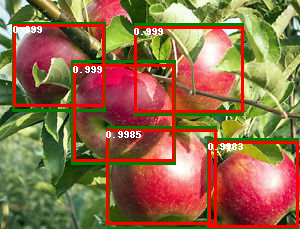

/content/train_zip/train/mixed_18.jpg
[[ 67. 163. 441. 541.]
 [209. 134. 866. 348.]
 [263. 267. 849. 551.]]
/content/train_zip/train/mixed_18.jpg
[[ 67. 163. 441. 541.]
 [209. 134. 866. 348.]
 [263. 267. 849. 551.]]


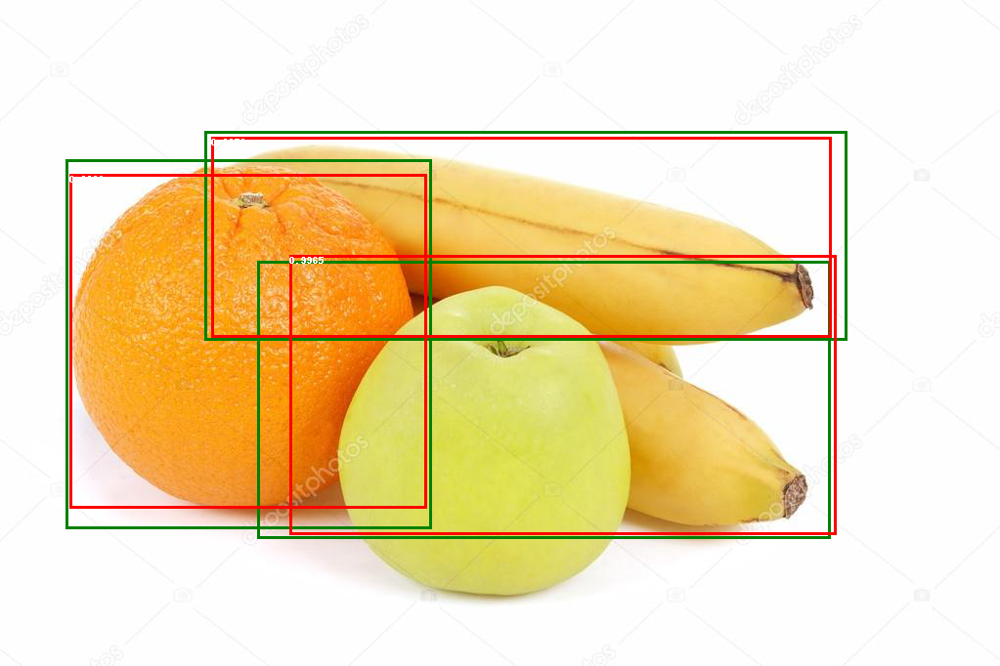

/content/train_zip/train/apple_16.jpg
[[ 14.  44. 270. 300.]]
/content/train_zip/train/apple_16.jpg
[[ 14.  44. 270. 300.]]


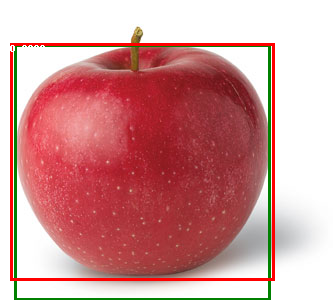

/content/train_zip/train/apple_24.jpg
[[1.100e+02 7.300e+02 9.130e+02 1.551e+03]
 [1.000e+00 1.000e+00 4.070e+02 6.170e+02]
 [1.040e+02 4.000e+00 6.240e+02 5.570e+02]]
/content/train_zip/train/apple_24.jpg
[[1.100e+02 7.300e+02 9.130e+02 1.551e+03]
 [1.000e+00 1.000e+00 4.070e+02 6.170e+02]
 [1.040e+02 4.000e+00 6.240e+02 5.570e+02]]


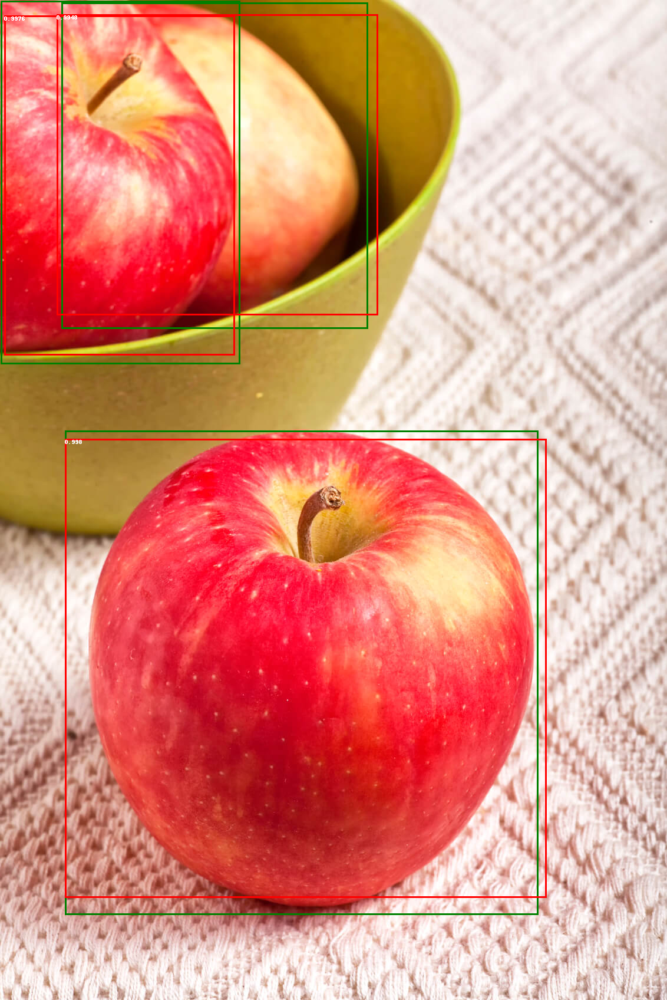

/content/train_zip/train/apple_84.jpg
[[ 64.  84. 484. 457.]
 [550.  44. 850. 356.]
 [197.   1. 559. 273.]]
/content/train_zip/train/apple_84.jpg
[[ 64.  84. 484. 457.]
 [550.  44. 850. 356.]
 [197.   1. 559. 273.]]


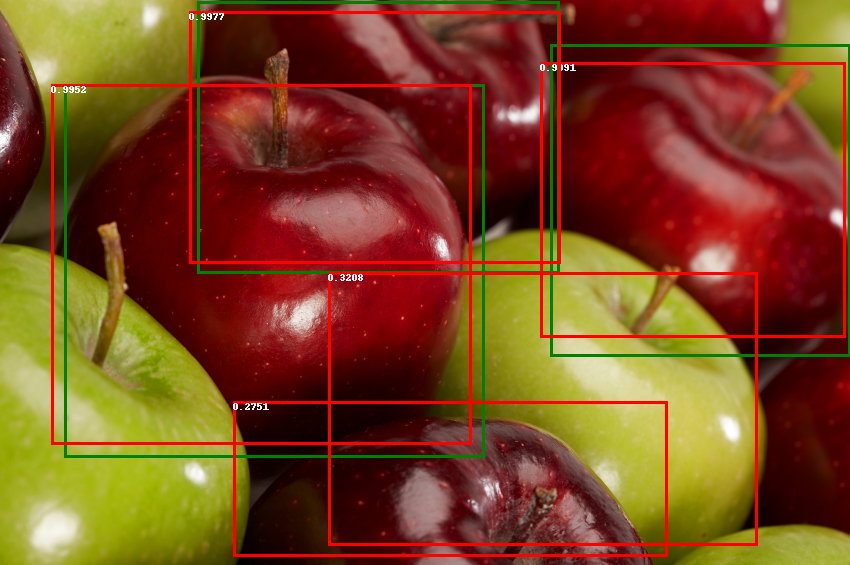

/content/train_zip/train/banana_72.jpg
[[5.700e+01 2.150e+02 1.711e+03 1.112e+03]
 [4.780e+02 2.640e+02 1.991e+03 1.332e+03]
 [1.000e+00 1.890e+02 1.594e+03 7.680e+02]]
/content/train_zip/train/banana_72.jpg
[[5.700e+01 2.150e+02 1.711e+03 1.112e+03]
 [4.780e+02 2.640e+02 1.991e+03 1.332e+03]
 [1.000e+00 1.890e+02 1.594e+03 7.680e+02]]


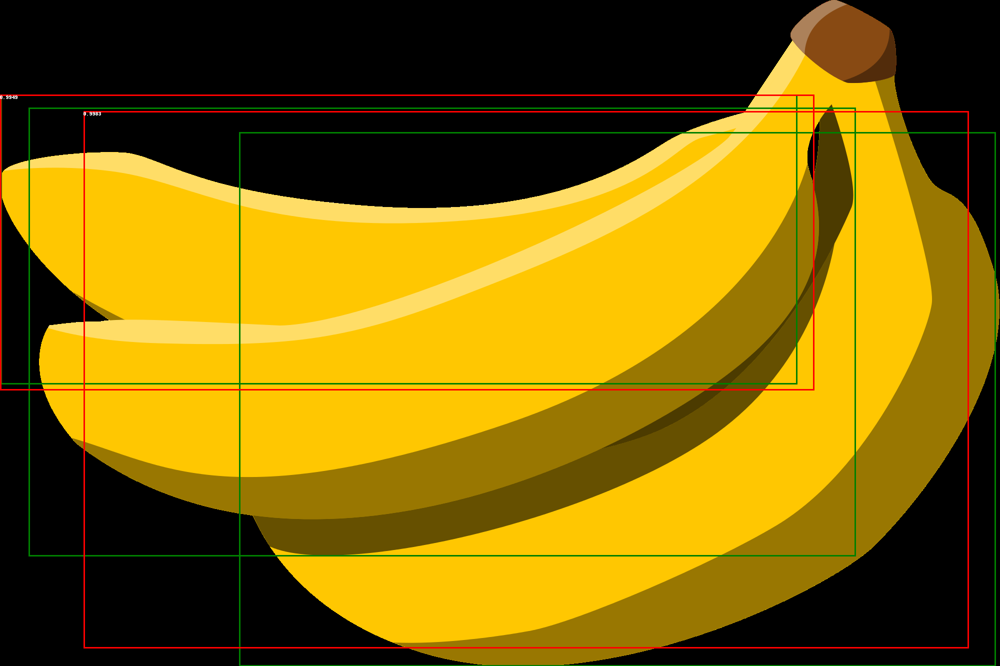

/content/train_zip/train/mixed_17.jpg
[[108. 277. 223. 376.]
 [518. 255. 598. 330.]
 [492. 198. 590. 275.]
 [122. 165. 379. 265.]
 [160. 207. 394. 302.]
 [296. 164. 453. 309.]
 [324. 214. 460. 343.]
 [301.  89. 410. 192.]
 [411. 122. 525. 227.]]
/content/train_zip/train/mixed_17.jpg
[[108. 277. 223. 376.]
 [518. 255. 598. 330.]
 [492. 198. 590. 275.]
 [122. 165. 379. 265.]
 [160. 207. 394. 302.]
 [296. 164. 453. 309.]
 [324. 214. 460. 343.]
 [301.  89. 410. 192.]
 [411. 122. 525. 227.]]


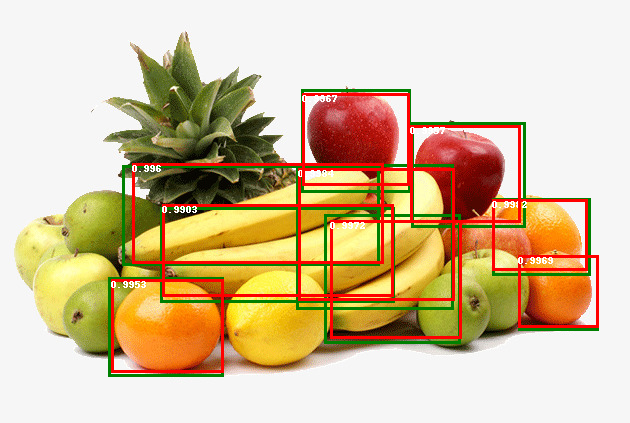

/content/train_zip/train/orange_81.jpg
[[  90.  287.  608.  809.]
 [ 560.  217. 1145.  769.]
 [ 323.   37.  786.  551.]]
/content/train_zip/train/orange_81.jpg
[[  90.  287.  608.  809.]
 [ 560.  217. 1145.  769.]
 [ 323.   37.  786.  551.]]


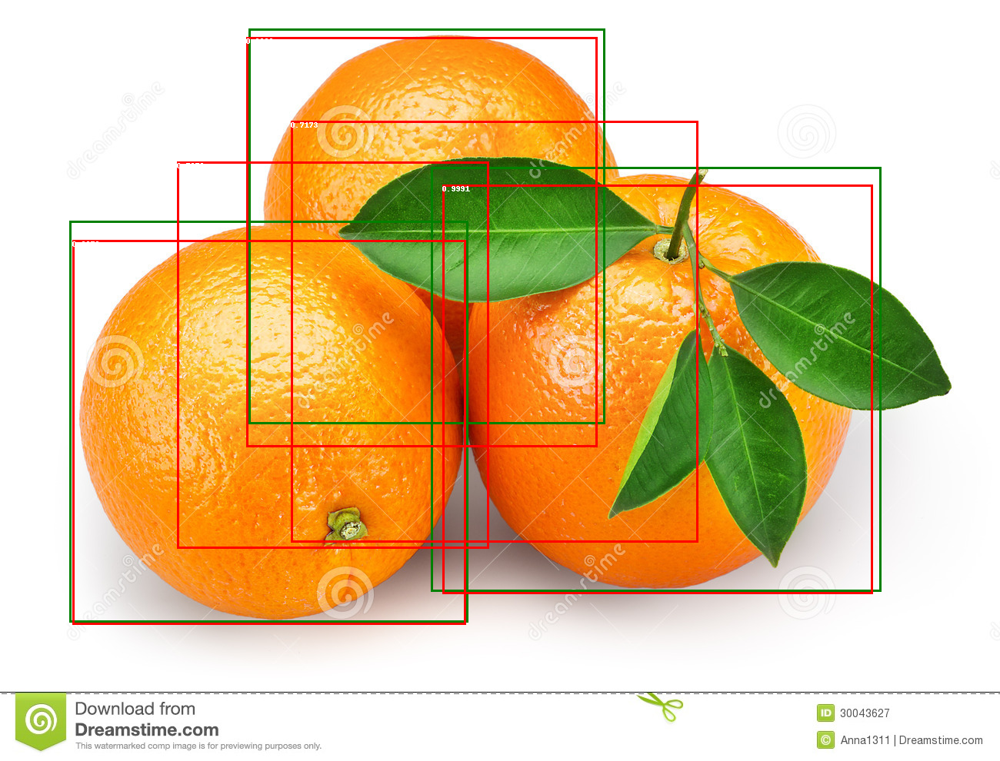

/content/train_zip/train/apple_50.jpg
[[147.  45. 288. 202.]
 [ 46.  40. 148. 149.]
 [ 86. 108. 197. 217.]]
/content/train_zip/train/apple_50.jpg
[[147.  45. 288. 202.]
 [ 46.  40. 148. 149.]
 [ 86. 108. 197. 217.]]


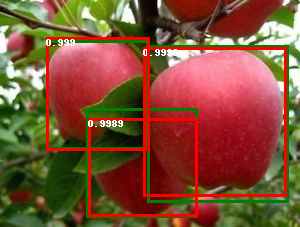

/content/train_zip/train/banana_75.jpg
[[144.  46. 340. 291.]]
/content/train_zip/train/banana_75.jpg
[[144.  46. 340. 291.]]


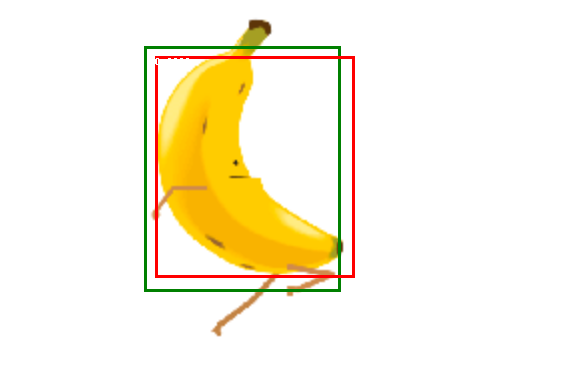

/content/train_zip/train/orange_81.jpg
[[  90.  287.  608.  809.]
 [ 560.  217. 1145.  769.]
 [ 323.   37.  786.  551.]]
/content/train_zip/train/orange_81.jpg
[[  90.  287.  608.  809.]
 [ 560.  217. 1145.  769.]
 [ 323.   37.  786.  551.]]


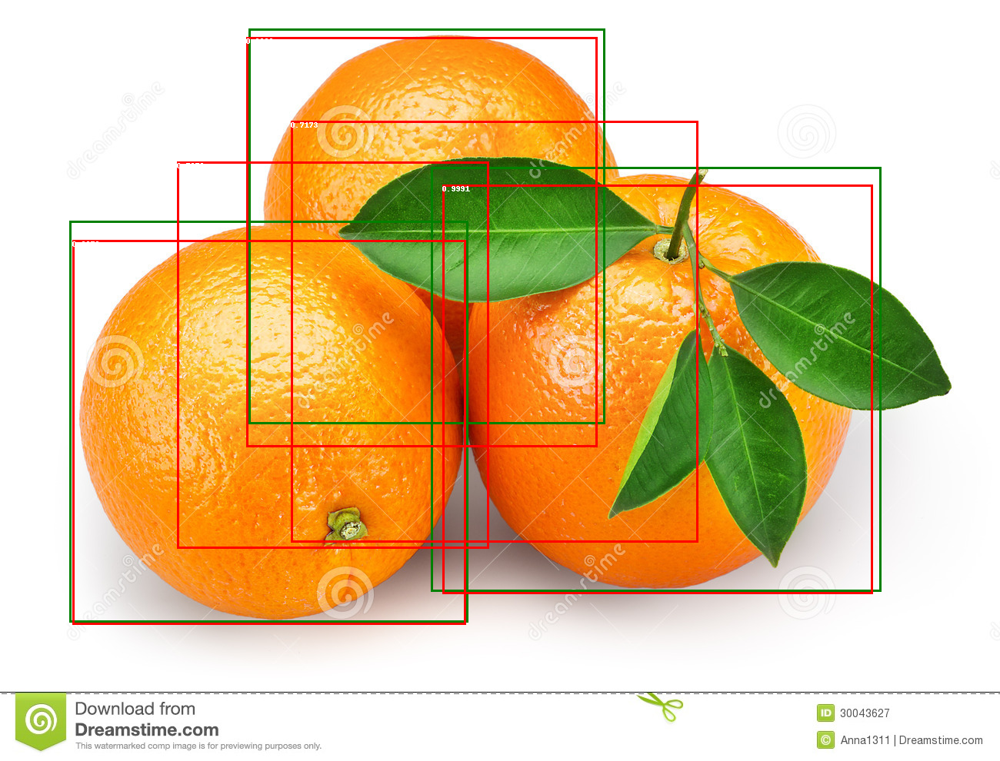

/content/train_zip/train/apple_69.jpg
[[ 95. 227. 262. 404.]
 [229. 219. 406. 376.]
 [169. 128. 348. 297.]]
/content/train_zip/train/apple_69.jpg
[[ 95. 227. 262. 404.]
 [229. 219. 406. 376.]
 [169. 128. 348. 297.]]


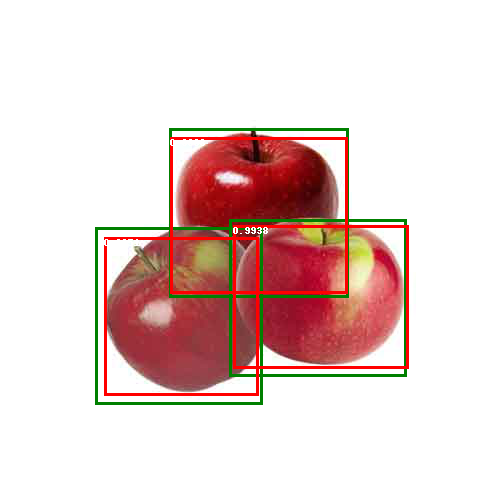

/content/train_zip/train/apple_28.jpg
[[ 25.  42. 275. 297.]]
/content/train_zip/train/apple_28.jpg
[[ 25.  42. 275. 297.]]


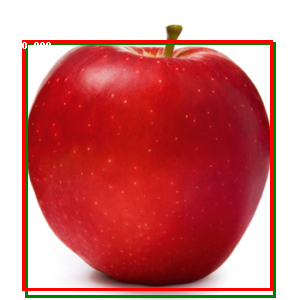

/content/train_zip/train/mixed_17.jpg
[[108. 277. 223. 376.]
 [518. 255. 598. 330.]
 [492. 198. 590. 275.]
 [122. 165. 379. 265.]
 [160. 207. 394. 302.]
 [296. 164. 453. 309.]
 [324. 214. 460. 343.]
 [301.  89. 410. 192.]
 [411. 122. 525. 227.]]
/content/train_zip/train/mixed_17.jpg
[[108. 277. 223. 376.]
 [518. 255. 598. 330.]
 [492. 198. 590. 275.]
 [122. 165. 379. 265.]
 [160. 207. 394. 302.]
 [296. 164. 453. 309.]
 [324. 214. 460. 343.]
 [301.  89. 410. 192.]
 [411. 122. 525. 227.]]


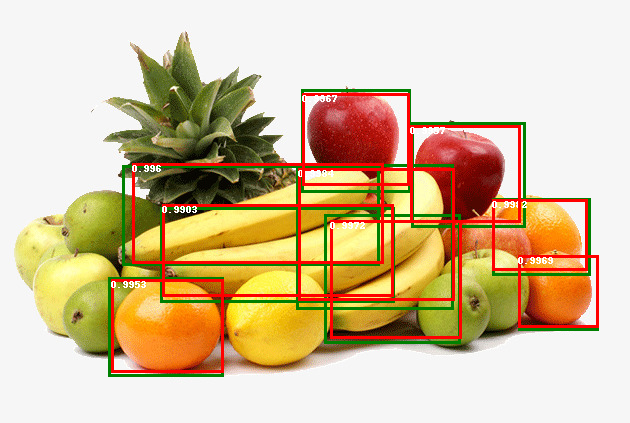

/content/train_zip/train/orange_23.jpg
[[ 78.  79. 257. 249.]]
/content/train_zip/train/orange_23.jpg
[[ 78.  79. 257. 249.]]


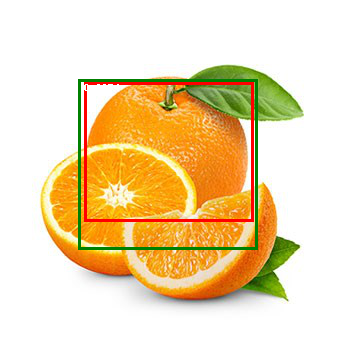

/content/train_zip/train/apple_56.jpg
[[349. 227. 861. 784.]]
/content/train_zip/train/apple_56.jpg
[[349. 227. 861. 784.]]


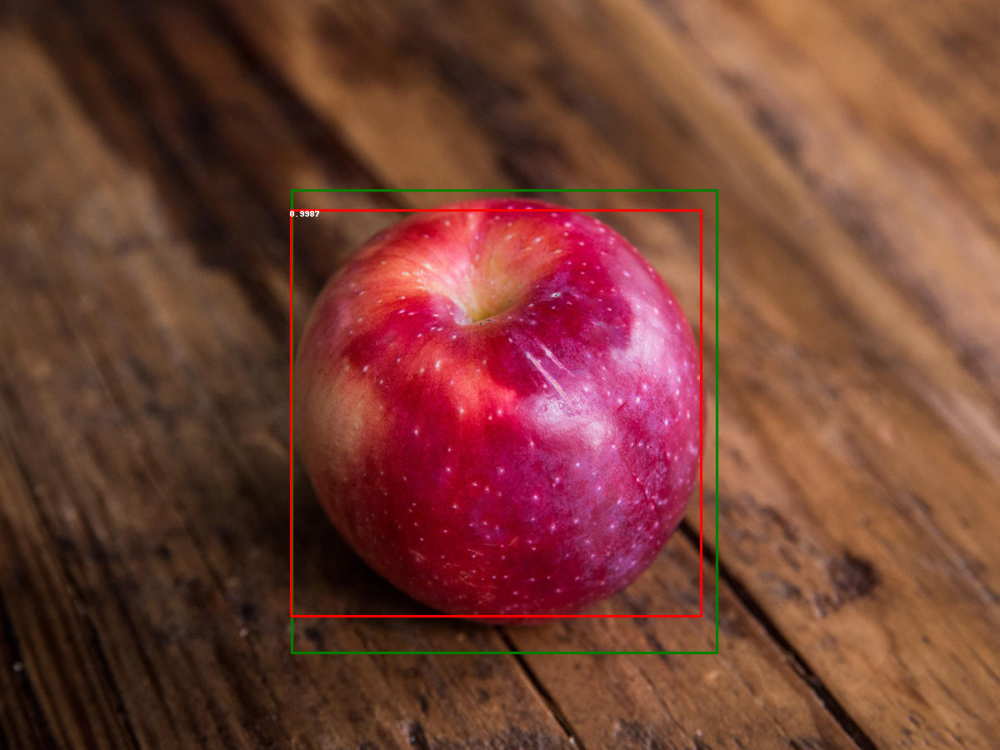

/content/train_zip/train/banana_20.jpg
[[ 78.  57. 394. 350.]
 [171.  49. 543. 224.]
 [158.  45. 524. 304.]
 [190.  51. 533. 255.]]
/content/train_zip/train/banana_20.jpg
[[ 78.  57. 394. 350.]
 [171.  49. 543. 224.]
 [158.  45. 524. 304.]
 [190.  51. 533. 255.]]


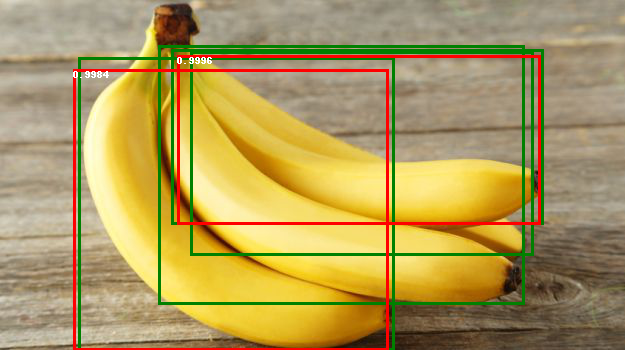

/content/train_zip/train/apple_77.jpg
[[ 71.  60. 175. 164.]
 [ 12.  22. 105. 111.]
 [134.  23. 243. 115.]
 [107. 126. 216. 229.]
 [207. 138. 298. 229.]]
/content/train_zip/train/apple_77.jpg
[[ 71.  60. 175. 164.]
 [ 12.  22. 105. 111.]
 [134.  23. 243. 115.]
 [107. 126. 216. 229.]
 [207. 138. 298. 229.]]


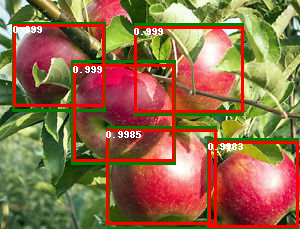

In [21]:
# Use this code to made a predition.
from PIL import ImageDraw
# Getting the image.
for idx in range(2,20):
    img, _ = test[idx]
    # Getting the object coordinates.
    label_boxes = np.array(test[idx][1]['boxes'])

    # Setting the model to eval state.
    model.eval()
    # Making the prediction.
    with torch.no_grad():
        prediction = model([img.to(DEVICE)])

    # Getting an drawing the image.
    image = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
    draw = ImageDraw.Draw(image)

    # Drawing the real box around the object.
    for elem in range(len(label_boxes)):
        draw.rectangle([(label_boxes[elem][0], label_boxes[elem][1]),
                       (label_boxes[elem][2], label_boxes[elem][3])],
                      outline='green', width=3)
    # Drawing the predicted box around the object.
    for element in range(len(prediction[0]['boxes'])):
        boxes = prediction[0]['boxes'][element].cpu().numpy()                                     
        score = np.round(prediction[0]['scores'][element].cpu().numpy(), decimals=4)

        if score > 0.2:
            draw.rectangle([(boxes[0], boxes[1]), (boxes[2], boxes[3])],
                         outline='red', width=3)
            draw.text((boxes[0], boxes[1]), text=str(score))
    display(image)